# 🚀 Garbage Detection for Water Cleaning Robot using Tuned YOLOv8 Model Momentum MU

### Welcome to our project!  
This work is part of **Momentum MU Team** at **Mansoura National University**, focusing on developing an intelligent **Water Cleaning Robot**. 🌊🤖

In this notebook, we demonstrate how we trained and tuned a **YOLOv8** model for **garbage detection** to be deployed directly on our robot.  
The robot will navigate and identify waste objects floating on water surfaces, enabling efficient and automated cleaning.

# 📸 Momentum MU Cleaning Robot 
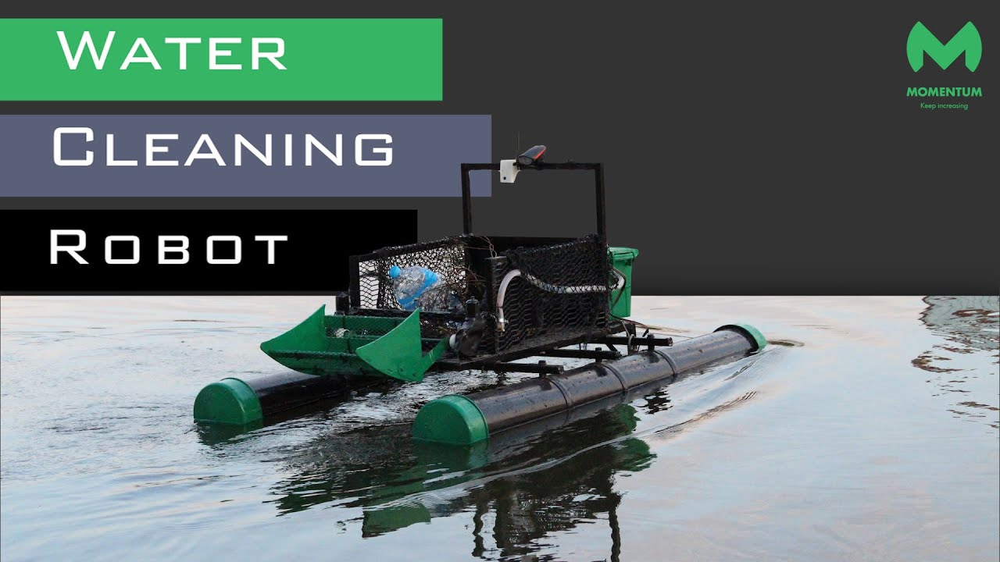

### 🛠️ Project Highlights:
- **Model**: YOLOv8 (custom-tuned for garbage detection)
- **Platform**: ESP32 WROOM + Robotic Unit
- **Purpose**: Detect and localize garbage items to assist in water cleaning.
- **Team**: Momentum MU Team - Mansoura University
- **Robot Name**: Water Cleaning Robot


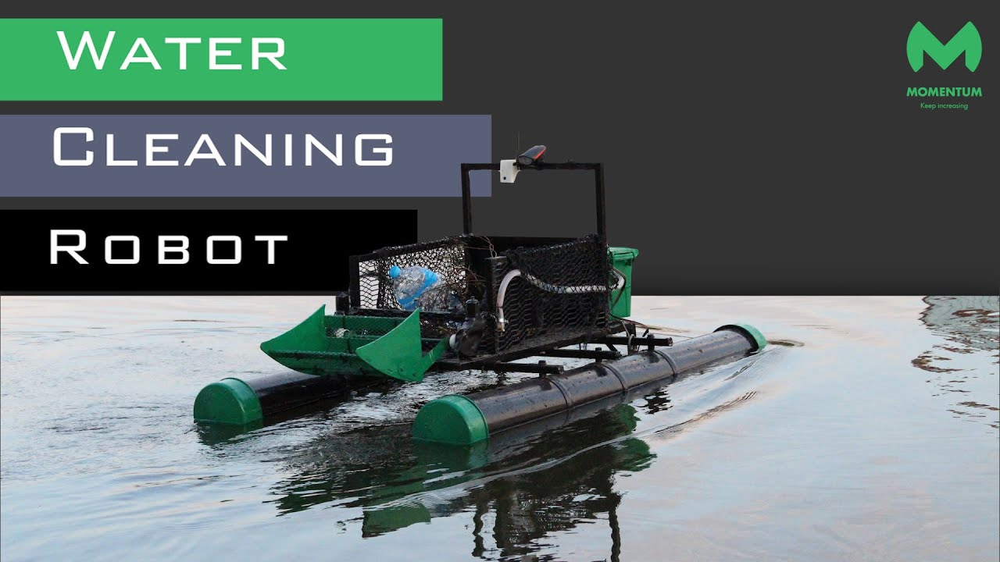
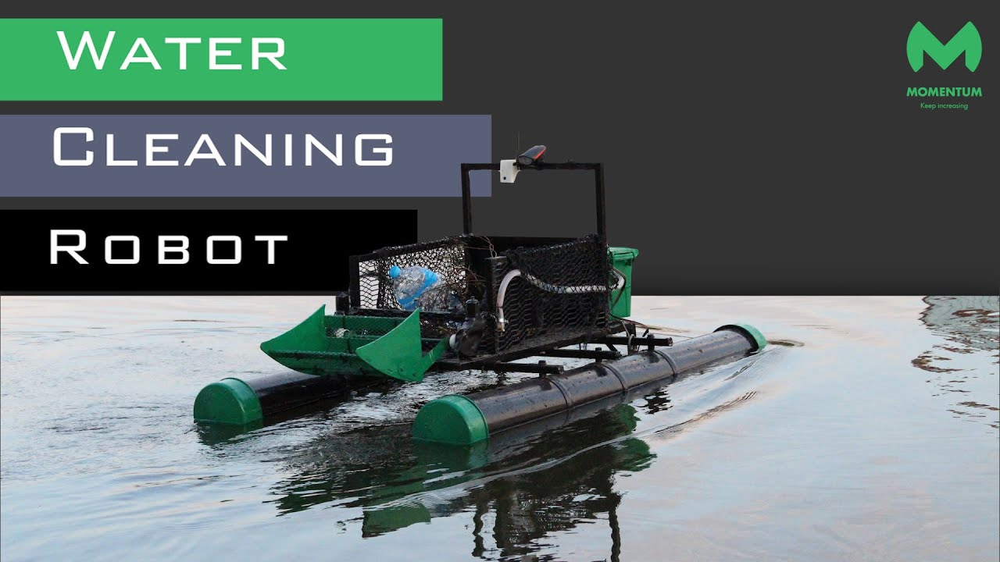
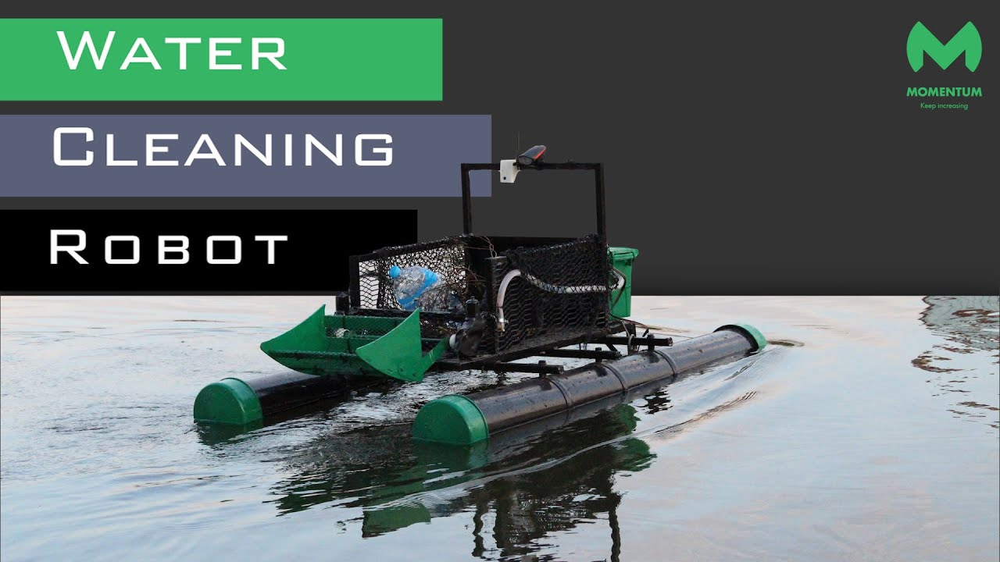
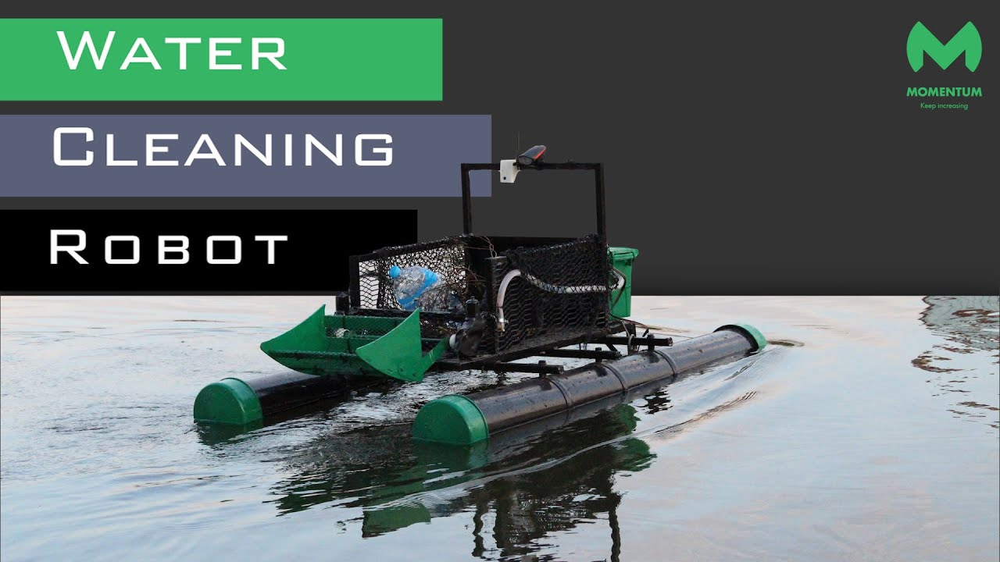
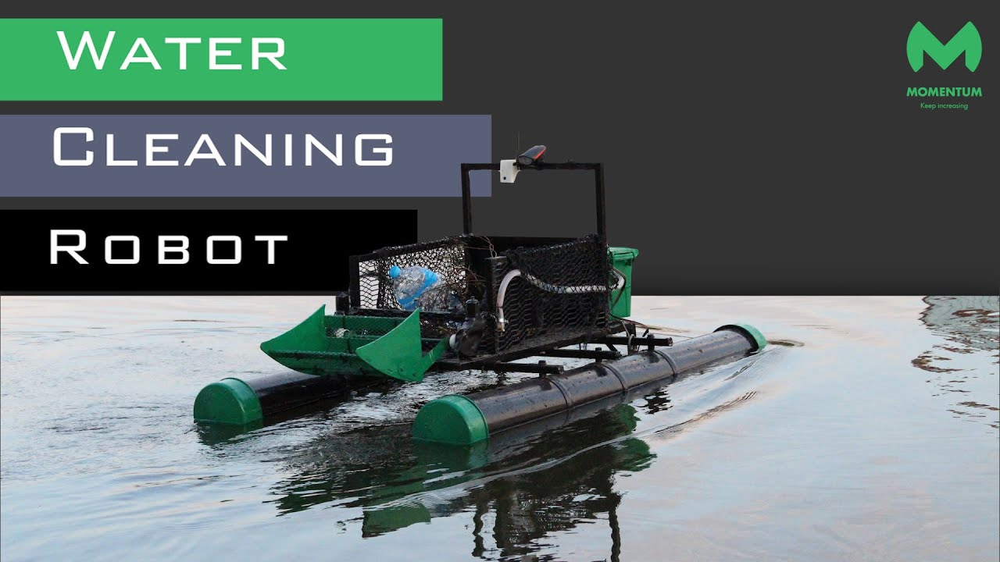

In [1]:
!ls /kaggle/input/garbage-data

data.yaml  README.dataset.txt  README.roboflow.txt  test  train  valid


In [2]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 984.2/984.2 kB 26.3 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.9 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 8.0 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 29.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.4 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.5 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 81.1 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.8.93
    Uninstalling nvidia-nvjitlink-cu12-12.8.93:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.8.93
  Attempting uninstall: nvidia-curand-cu12
    Found exi

In [4]:
!cp -r /kaggle/input/garbage-data /kaggle/working/garbage-data

# Explor The Data

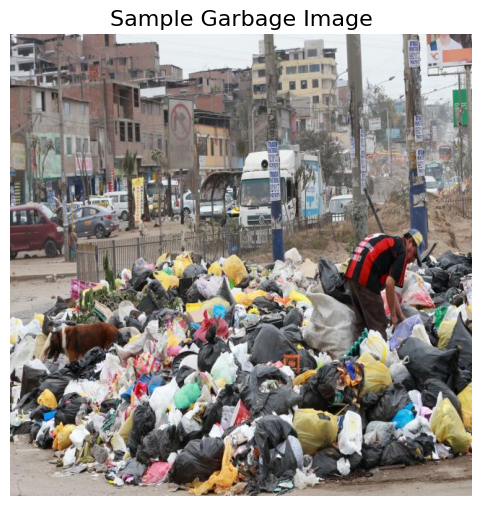

In [30]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load your image
img = mpimg.imread('/kaggle/working/garbage-data/train/images/000545081W_jpg.rf.feca471c9b6a6e19bb78d8a8dd509298.jpg')

# Plot the image
plt.figure(figsize=(8, 6))  # you can change the size if you want
plt.imshow(img)
plt.axis('off')  # Hide axis
plt.title('Sample Garbage Image', fontsize=16)
plt.show()


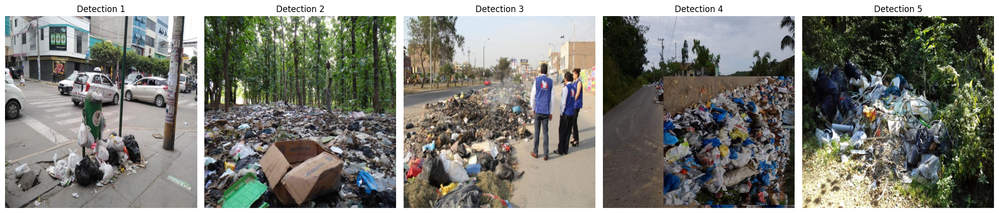

In [32]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load your five images
img1 = mpimg.imread('/kaggle/working/garbage-data/train/images/000568727W_jpg.rf.10438490dc09a5e1da5dad923824a637.jpg')
img2 = mpimg.imread('/kaggle/working/garbage-data/valid/images/004633f2-679f-11e5-b0e3-40f2e96c8ad8_jpg.rf.c7fb6b39d01d029e82c697391873876d.jpg')
img3 = mpimg.imread('/kaggle/working/garbage-data/valid/images/000273202W_jpg.rf.2a0c7f191a80ad024b90ce66a2cb69c0.jpg')
img4 = mpimg.imread('/kaggle/working/garbage-data/train/images/05-_RESAH_jpg.rf.88fa789ca32b7e2debd198713f1debc3.jpg')
img5 = mpimg.imread('/kaggle/working/garbage-data/train/images/-de-s-enfoncer-tres-loin-pour-tomber-sur-des-immondices-photos-rl-15403880372_jpg.rf.7d0befa323c2f0ff9680687398f6f68a.jpg')

# Create a figure
fig, axes = plt.subplots(1, 5, figsize=(20, 5))  # 1 row, 5 columns

# List of images
images = [img1, img2, img3, img4, img5]
titles = ['Detection 1', 'Detection 2', 'Detection 3', 'Detection 4', 'Detection 5']

# Plot each image
for i in range(5):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(titles[i], fontsize=12)

plt.tight_layout()
plt.show()


# Update the ymal file 

In [6]:
import os
dataset_path = '/kaggle/working/garbage-data'

In [7]:
with open(os.path.join(dataset_path, 'data.yaml'), 'r') as f:
    yaml_content = f.read()
yaml_content = yaml_content.replace('train: train', f'train: {dataset_path}/train')
yaml_content = yaml_content.replace('val: valid', f'val: {dataset_path}/valid')
yaml_content = yaml_content.replace('test: test', f'test: {dataset_path}/test')
with open(os.path.join(dataset_path, 'data.yaml'), 'w') as f:
    f.write(yaml_content)

# Train the model using the updated data.yaml

In [8]:
!yolo task=detect mode=train model=yolov8n.pt data=/kaggle/working/garbage-data/data.yaml epochs=50 imgsz=640 batch=16 name=yolov8n_garbage

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
100%|███████████████████████████████████████| 6.25M/6.25M [00:00<00:00, 107MB/s]
Ultralytics 8.3.117 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/kaggle/working/garbage-data/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8n_garbage, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=Tr

In [12]:
!ls //kaggle/working/runs/detect/yolov8n_garbage/weights

best.pt  last.pt


In [13]:
!yolo task=detect mode=val model=/kaggle/working/runs/detect/yolov8n_garbage/weights/best.pt data=/kaggle/working/garbage-data/data.yaml

Ultralytics 8.3.117 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1567.5±919.9 MB/s, size: 80.2 KB)
val: Scanning /kaggle/working/garbage-data/valid/labels.cache... 260 images, 8 b
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 2, len(boxes) = 271. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all        260        271      0.894      0.842      0.862      0.567
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: inva

In [14]:
!yolo task=detect mode=predict model=/kaggle/working/runs/detect/yolov8n_garbage/weights/best.pt source=/kaggle/working/garbage-data/test/images conf=0.25 save=True

Ultralytics 8.3.117 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs

image 1/258 /kaggle/working/garbage-data/test/images/000144244W_jpg.rf.d1dc6442492ffbc7bcce5f0412bfea66.jpg: 640x640 3 garbages, 6.2ms
image 2/258 /kaggle/working/garbage-data/test/images/000839979_896x598_c_jpg.rf.04eba3aa5dbc551810d5b28ac9c38c53.jpg: 640x640 1 garbage, 6.0ms
image 3/258 /kaggle/working/garbage-data/test/images/02f330f2-9439-11e5-982d-40f2e96c8ad8_jpg.rf.af9f304e5a78fc6f84d268edef376fe3.jpg: 640x640 1 garbage, 5.4ms
image 4/258 /kaggle/working/garbage-data/test/images/07ff75e6-6799-11e5-8dd0-40f2e96c8ad8_jpg.rf.6e2fc221cd02c7e37fec6ca9af25d9f5.jpg: 640x640 1 garbage, 5.3ms
image 5/258 /kaggle/working/garbage-data/test/images/0_The-rubbish-left-behind-in-Sefton-ParkPic-Andrew-Teebay_jpg.rf.e04ea6eb8b005b7c768ef3abda9389b8.jpg: 640x640 1 garbage, 5.3ms
image 6/258 /kaggle/working/garbage-data/test

# Predicted Images

In [16]:
!ls /kaggle/working/runs/detect/predict

000144244W_jpg.rf.d1dc6442492ffbc7bcce5f0412bfea66.jpg
000839979_896x598_c_jpg.rf.04eba3aa5dbc551810d5b28ac9c38c53.jpg
02f330f2-9439-11e5-982d-40f2e96c8ad8_jpg.rf.af9f304e5a78fc6f84d268edef376fe3.jpg
07ff75e6-6799-11e5-8dd0-40f2e96c8ad8_jpg.rf.6e2fc221cd02c7e37fec6ca9af25d9f5.jpg
0ed6fe62-9439-11e5-982d-40f2e96c8ad8_jpg.rf.632814891b404ce212650bdc302e8852.jpg
0_The-rubbish-left-behind-in-Sefton-ParkPic-Andrew-Teebay_jpg.rf.e04ea6eb8b005b7c768ef3abda9389b8.jpg
1076103483_015339992667_1920x0_80_0_0_f714d219f1a26124d2452fce46923cc2_jpg.rf.bf57dc5ef46e5c203dbad32368654149.jpg
_117865773_1a9c9b4a-d985-4f48-82be-0beeaeaecec8_jpg.rf.5d2ac3aa62369648d48c1f07a83aedb7.jpg
1200x680_whatsapp_image_2021-09-26_at_10-12-35_jpg.rf.2ee83e27a1153d1e24d46b88f37923f8.jpg
12311590-679b-11e5-9696-40f2e96c8ad8_jpg.rf.555d843b794918eb6086292dd083538e.jpg
1280x680_075_acar-notitle200325_npwwq_jpg.rf.556cb5f262517b5b56e3242a5816651a.jpg
162645714460f1c438246b2_1626457144_3x2_md_jpg.rf.018f84b9098c66ebb17dd57c32

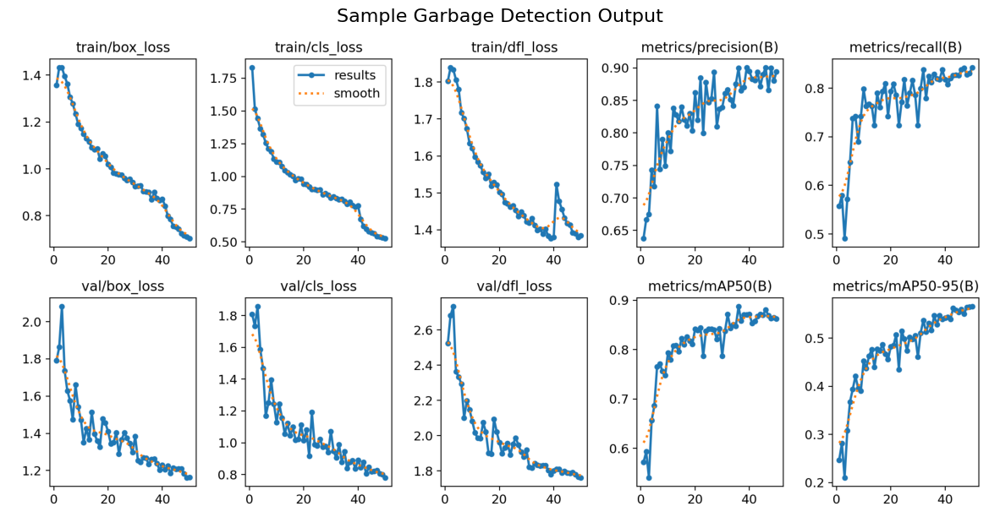

In [25]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load your image
img = mpimg.imread('/kaggle/working/runs/detect/yolov8n_garbage/results.png')

# Plot the image
plt.figure(figsize=(15, 8))  # you can change the size if you want
plt.imshow(img)
plt.axis('off')  # Hide axis
plt.title('Sample Garbage Detection Output', fontsize=16)
plt.show()


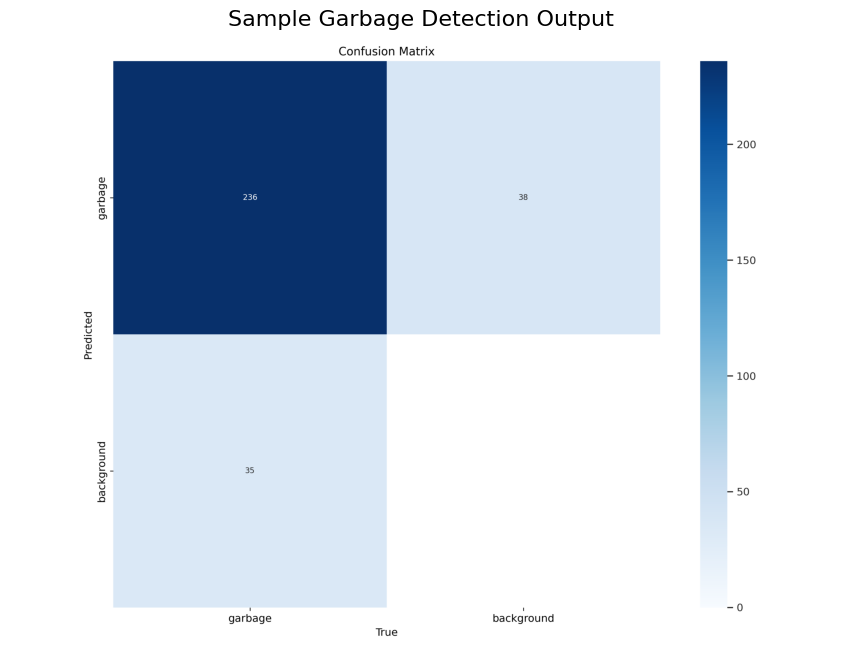

In [24]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load your image
img = mpimg.imread('/kaggle/working/runs/detect/yolov8n_garbage/confusion_matrix.png')

# Plot the image
plt.figure(figsize=(15, 8))  # you can change the size if you want
plt.imshow(img)
plt.axis('off')  # Hide axis
plt.title('Sample Garbage Detection Output', fontsize=16)
plt.show()


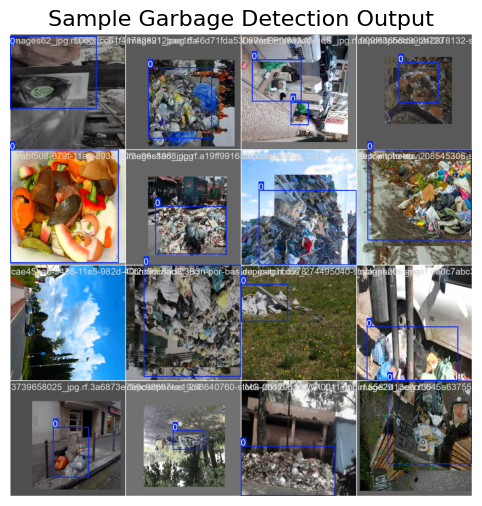

In [21]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load your image
img = mpimg.imread('/kaggle/working/runs/detect/yolov8n_garbage/train_batch9202.jpg')

# Plot the image
plt.figure(figsize=(8, 6))  # you can change the size if you want
plt.imshow(img)
plt.axis('off')  # Hide axis
plt.title('Sample Garbage Detection Output', fontsize=16)
plt.show()


Displaying: segnalazione_jpg.rf.cbf5bcf1285ecff1f98fc1a96c2f39d5.jpg


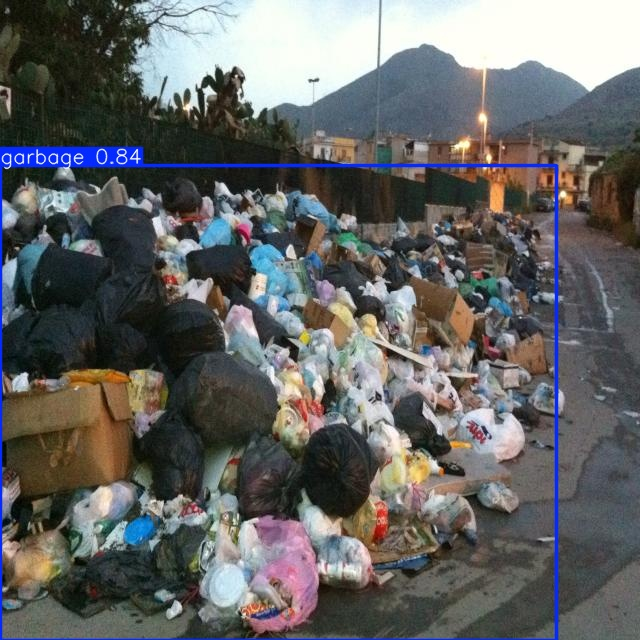

Displaying: fad5823e-6798-11e5-8dd0-40f2e96c8ad8_jpg.rf.e14c9112533b52c2d6e2e08d427c38dd.jpg


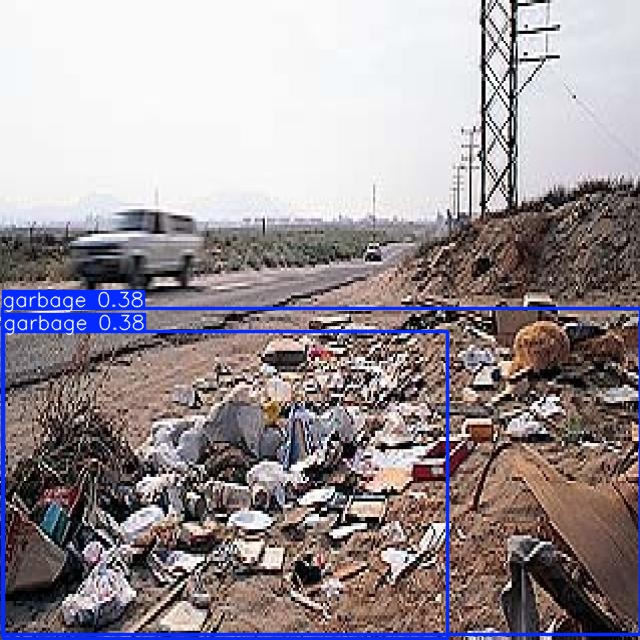

Displaying: 9aba0088-9438-11e5-982d-40f2e96c8ad8_jpg.rf.ed7a070c8d591582b99fa10bb1675874.jpg


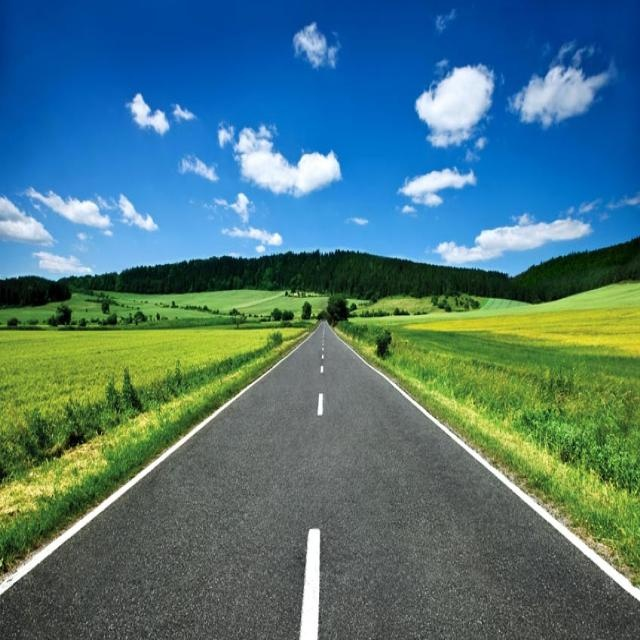

Displaying: images149_jpg.rf.52b868e9d27af4f1a67e060140482ca6.jpg


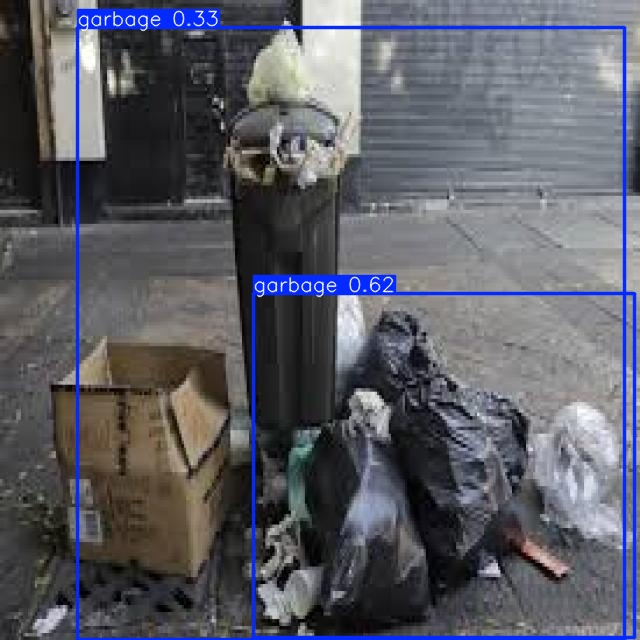

Displaying: c97d0eb4-6798-11e5-8dd0-40f2e96c8ad8_jpg.rf.f96f9b64fdcb5909d0f8ab0ff6914884.jpg


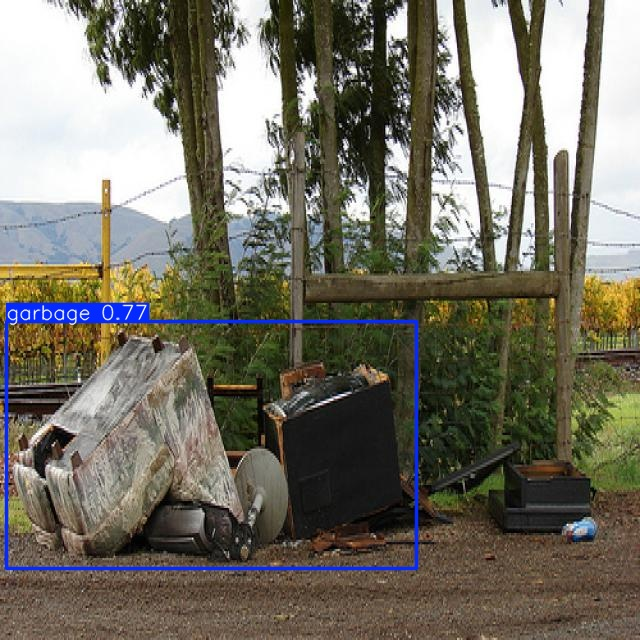

Displaying: 1280x680_075_acar-notitle200325_npwwq_jpg.rf.556cb5f262517b5b56e3242a5816651a.jpg


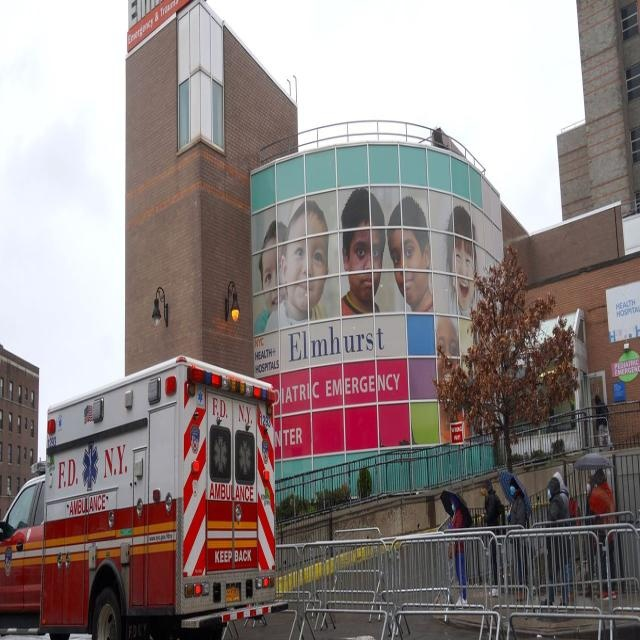

Displaying: telechargement-1-_jpg.rf.5f221e04a8dffb0e307a4c9077b747f9.jpg


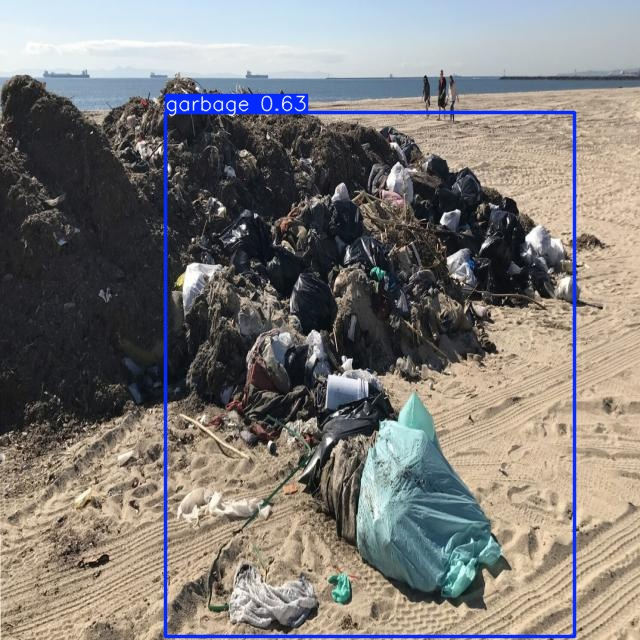

Displaying: 000144244W_jpg.rf.d1dc6442492ffbc7bcce5f0412bfea66.jpg


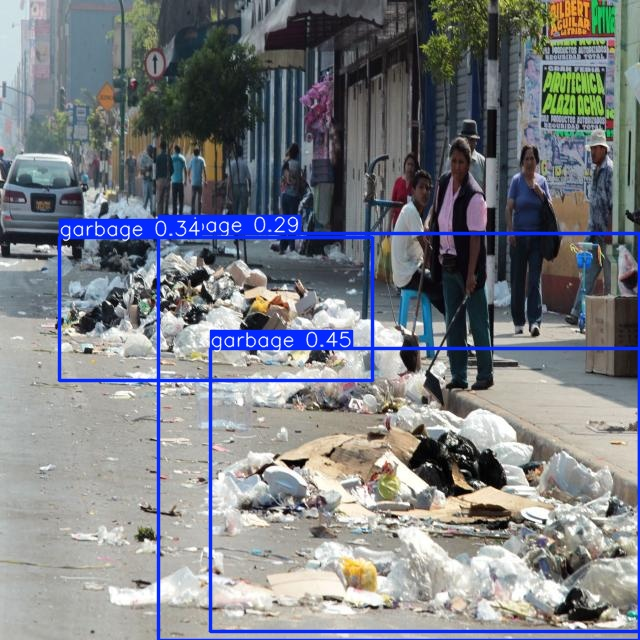

Displaying: Que-es-la-contaminacion-de-basura-en-las-calles_jpg.rf.4a76d1f8f82c03be66813741d3c0d379.jpg


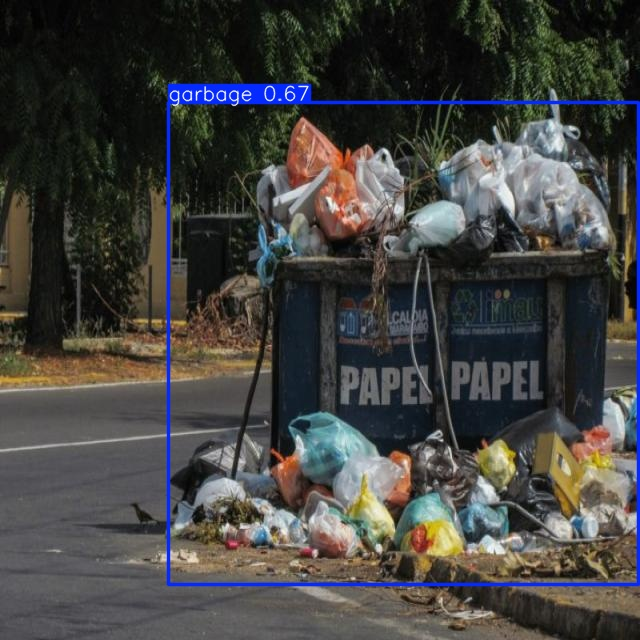

Displaying: image2_jpeg.rf.6cf31ea3d1d68049268f4a4ea8c2d229.jpg


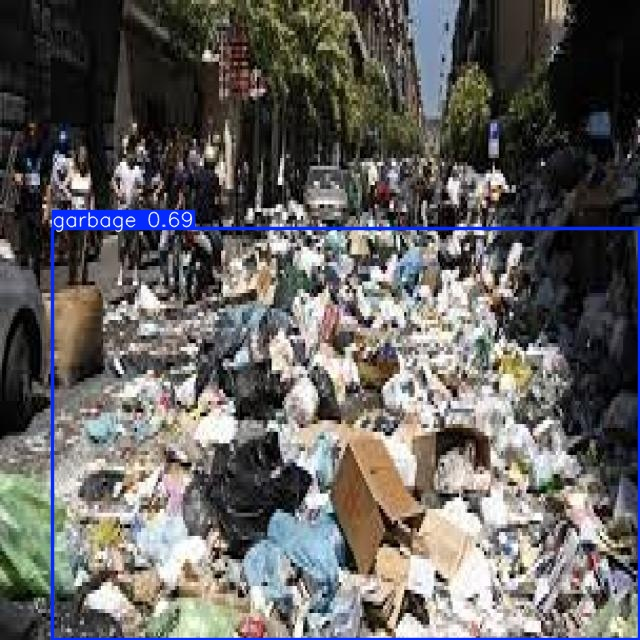

Displaying: cbd479be-6797-11e5-8c9e-40f2e96c8ad8_jpg.rf.958bd8f6afeb72fa673d0d44c80f5ae3.jpg


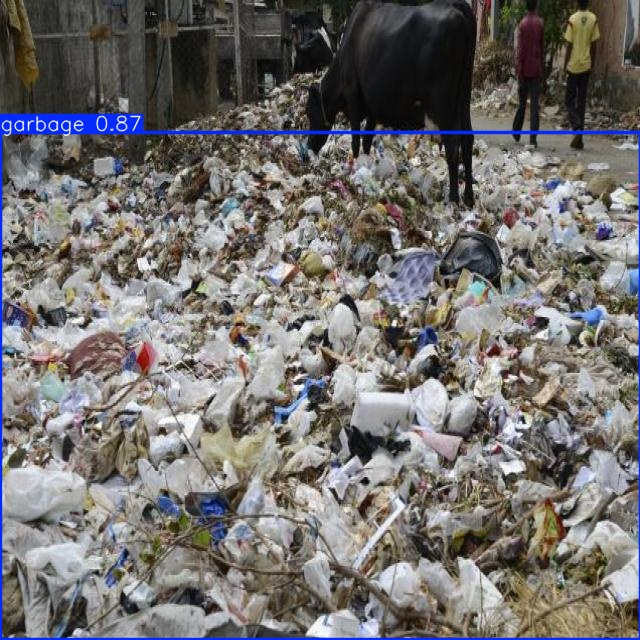

Displaying: cb7f2eb8-6798-11e5-8dd0-40f2e96c8ad8_jpg.rf.99f009b478a751c7d83892e88932e415.jpg


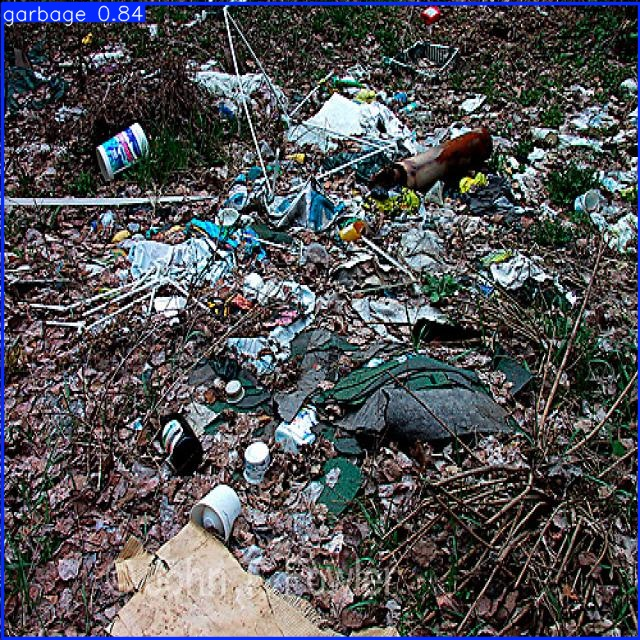

Displaying: images74_jpg.rf.452fb1255d62fd113d9c4d023a5f590d.jpg


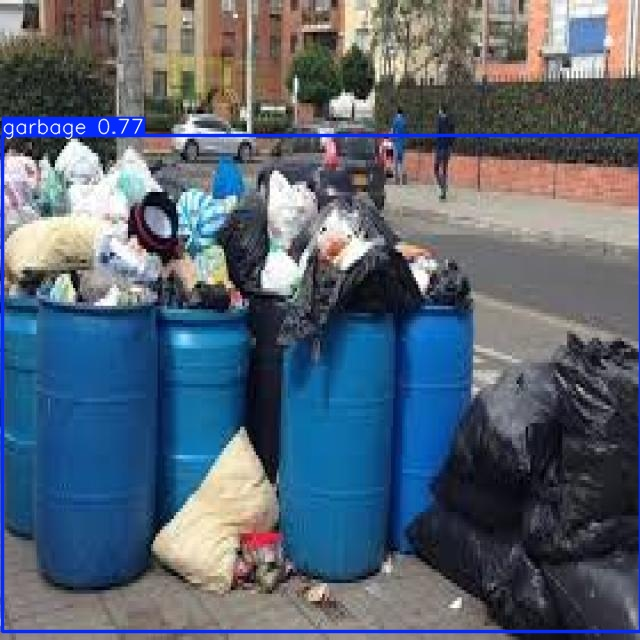

Displaying: garbage-in-trash-with-black-bag-at-park-picture-id1172153727_jpg.rf.c640fc219db02a2340905662b314965f.jpg


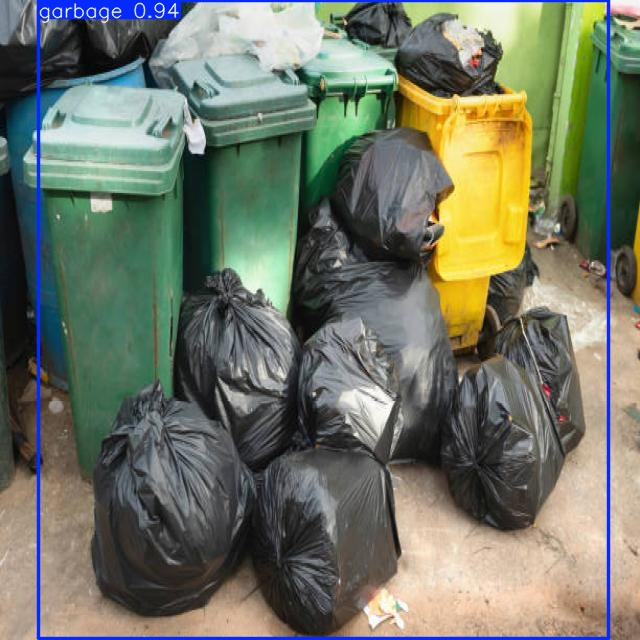

Displaying: mull-1_1558549054_jpg.rf.89fa1c5baa5f9df881a2ce3408a7dc88.jpg


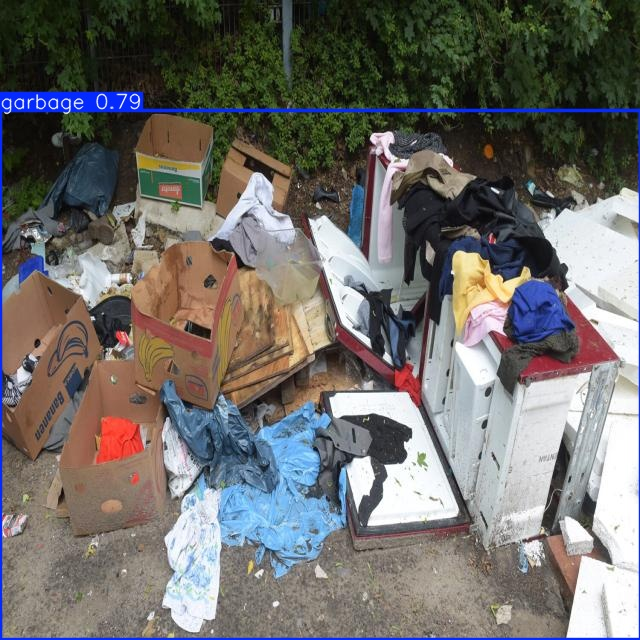

Displaying: cb079cc2-6798-11e5-8dd0-40f2e96c8ad8_jpg.rf.2b0e37fe6c0a13b09cb5d09d2a23a6f0.jpg


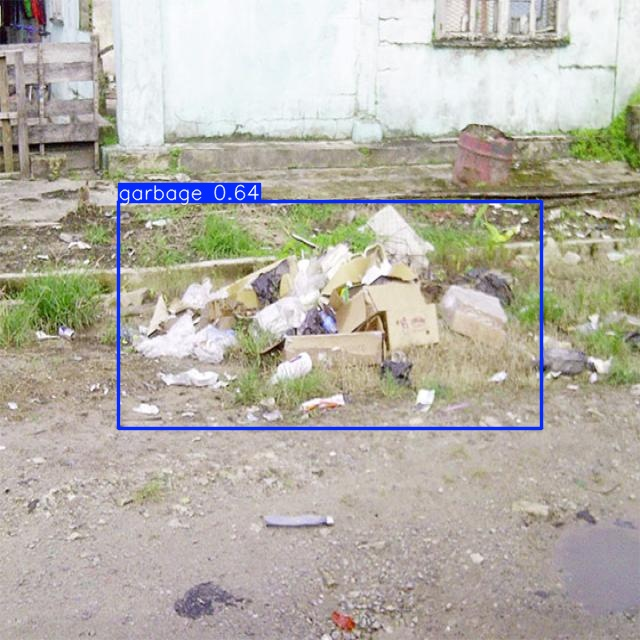

Displaying: images-2-_jpg.rf.a8f53a6e1d55567c2678fc10b387fbf9.jpg


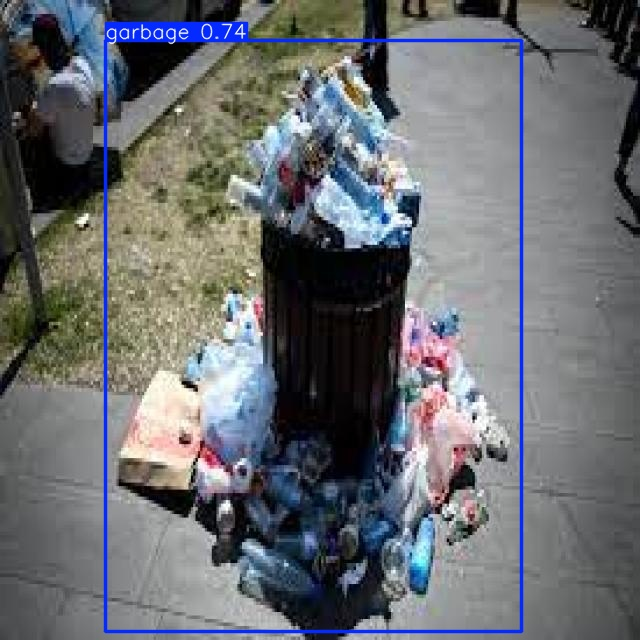

Displaying: images251_jpg.rf.3ae8ba087dd9735400d28f2d445a61b0.jpg


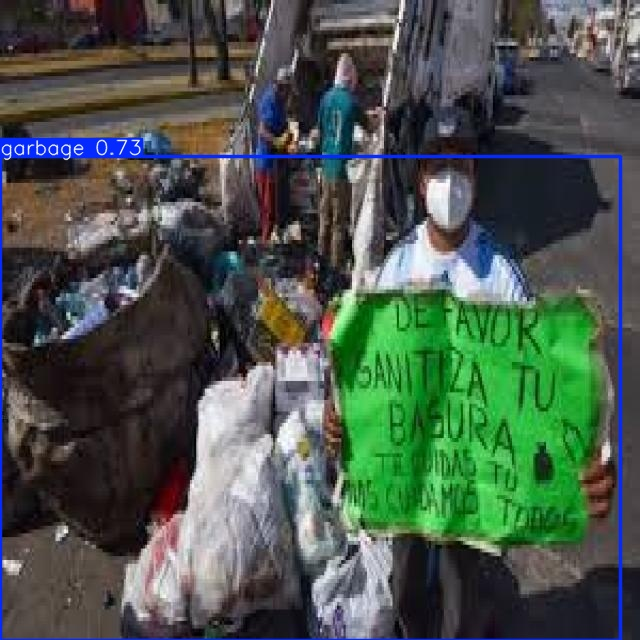

Displaying: depositphotos_290716408-stock-photo-big-and-many-plastic-garbage3_jpg.rf.7fa5fe17819d550786a863e75ba97e07.jpg


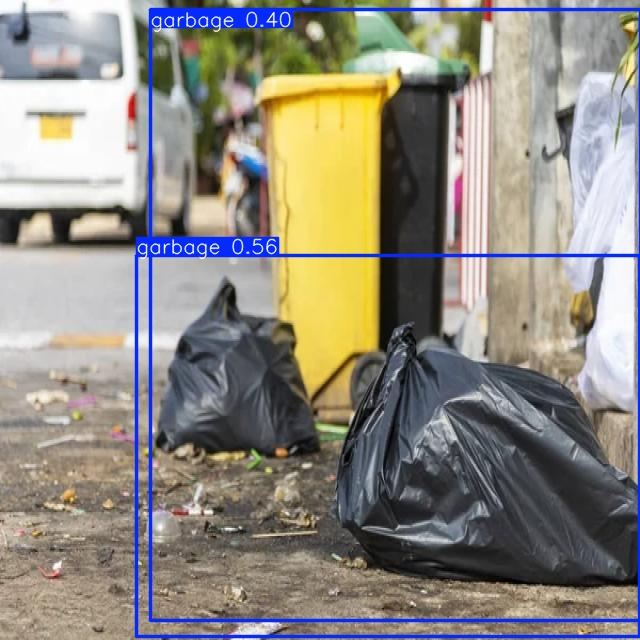

Displaying: A-Rome-les-rues-jonchees-d-ordures-font-craindre-une-crise-sanitaire_jpg.rf.95198ff46488bf93cb9655306c1416e8.jpg


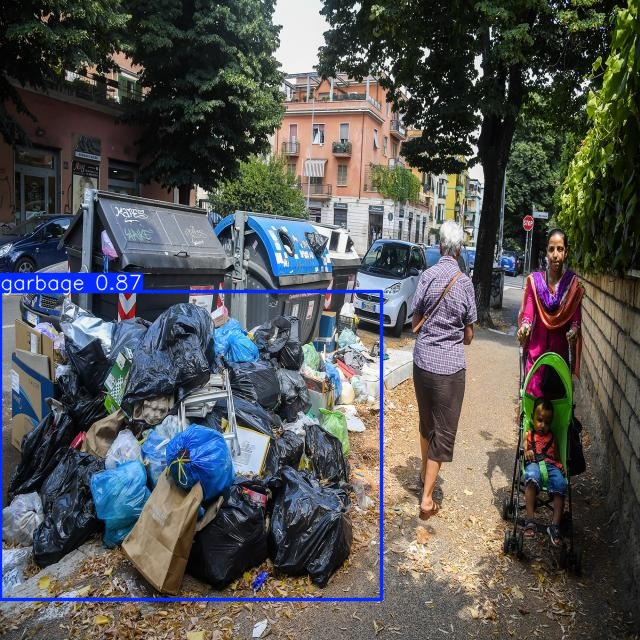

Displaying: ba076ca4-6798-11e5-8dd0-40f2e96c8ad8_jpg.rf.6dcd14d309f93cdd3c844056c8c5fe52.jpg


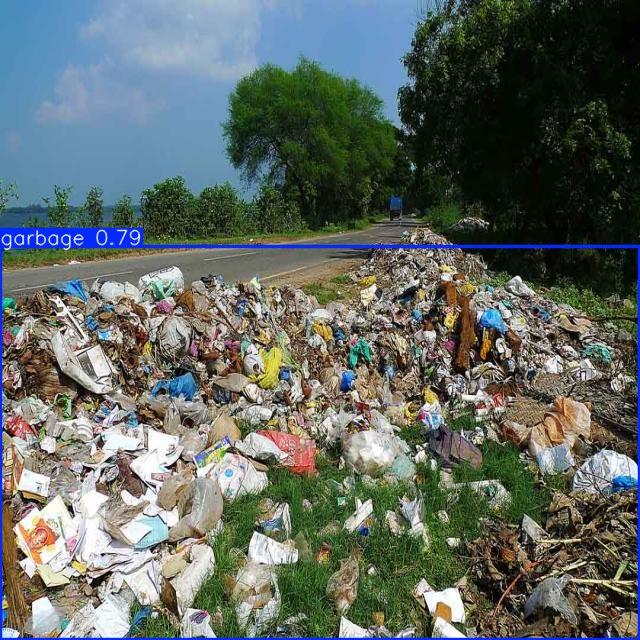

Displaying: images45_jpg.rf.9e0112dd87d2048983af07b2420c64bc.jpg


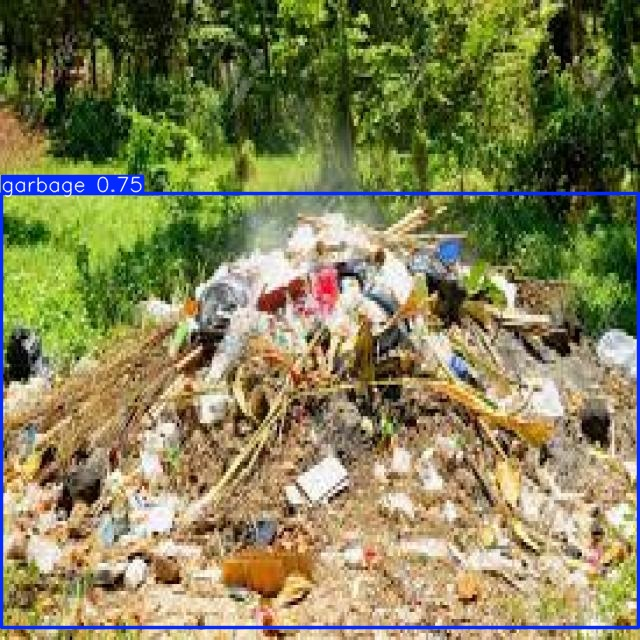

Displaying: c8b35114-6798-11e5-8dd0-40f2e96c8ad8_jpg.rf.7d72790a93d01ba0e5d320c6768e6ac3.jpg


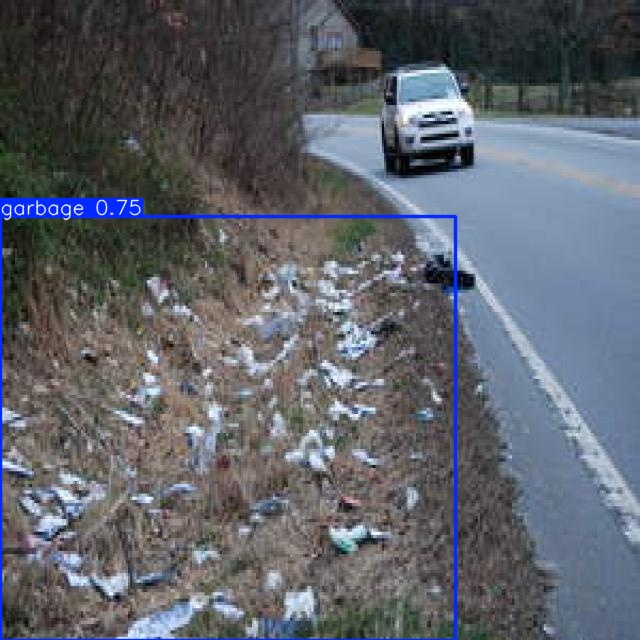

Displaying: 44ab3b5e-679b-11e5-af8c-40f2e96c8ad8_jpg.rf.c4283862088d6f891b5ab5f040f5bf1d.jpg


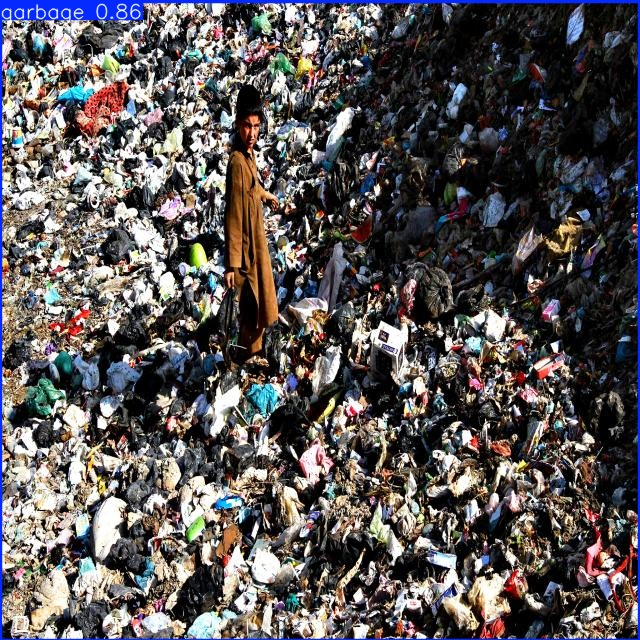

Displaying: 95406aa8-679b-11e5-a533-40f2e96c8ad8_jpg.rf.86e25aaba765712e71567bd12c1bd08e.jpg


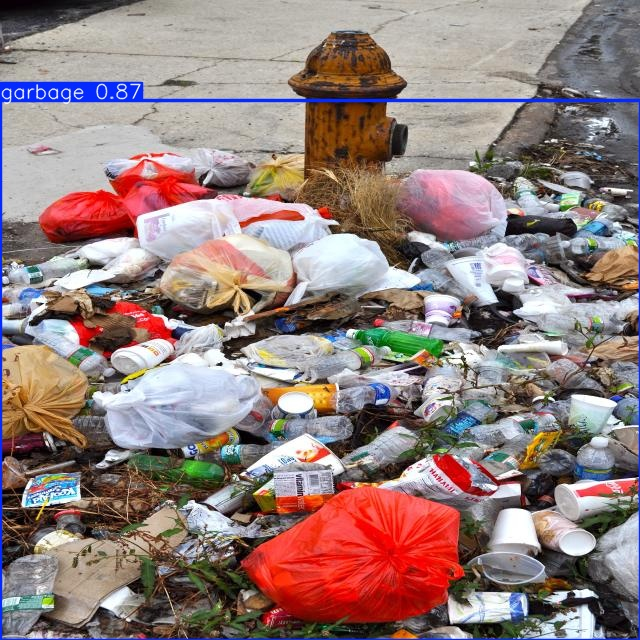

Displaying: collecte-dechets_jpg.rf.36986b4e692704604641c568aa116332.jpg


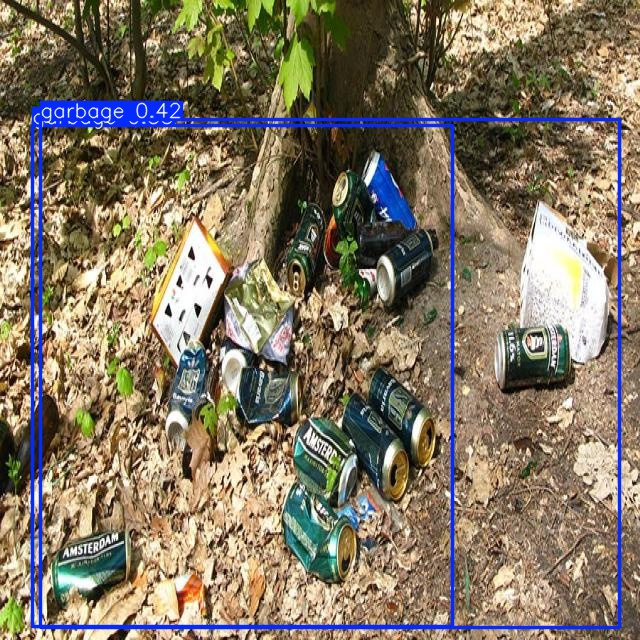

Displaying: lixo-da-poluiC3A7C3A3o-florestal-deixado-na-floresta-perto-estrada-176148111_jpg.rf.8c505327ad8a12895ff11924263589a3.jpg


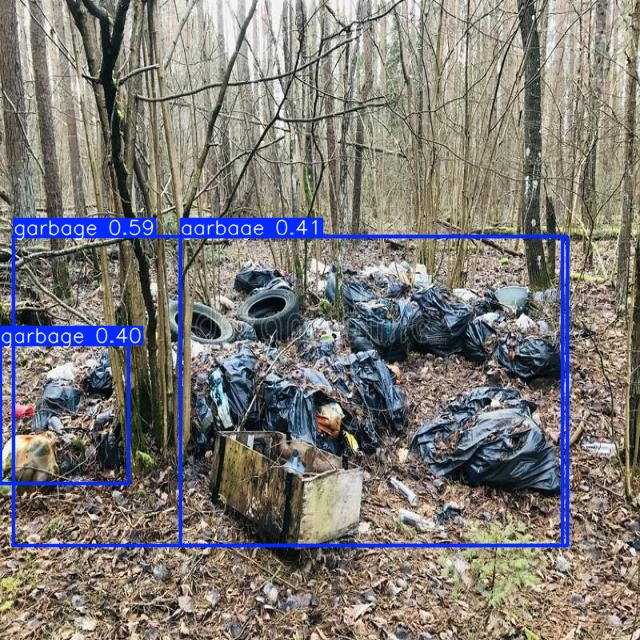

Displaying: 98d30a06-943a-11e5-ba6d-40f2e96c8ad8_jpg.rf.68d52f06061175ef793ebb1b34c9b00a.jpg


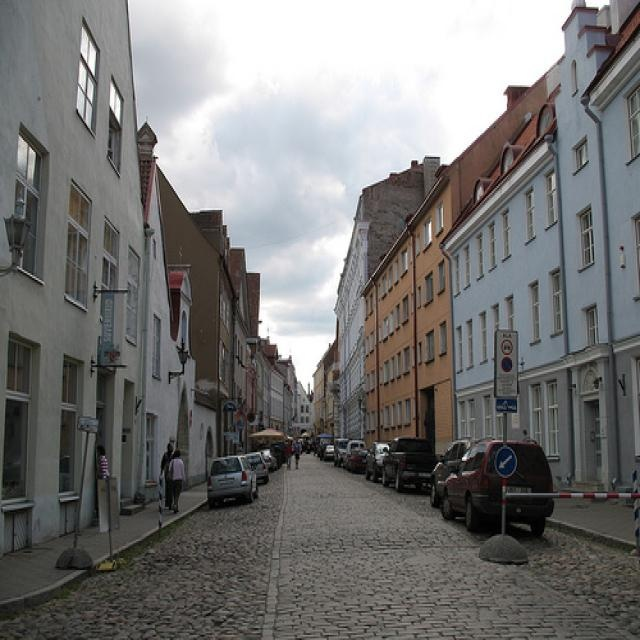

Displaying: depositphotos_227673224-stock-photo-junkyard-nature-blue-sky-clouds3_jpg.rf.f76fd7dc4b8d575503b840f7628c6c2c.jpg


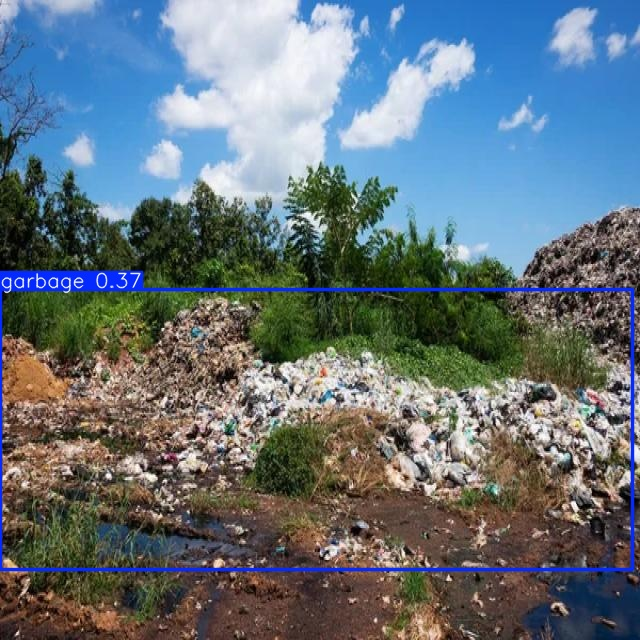

Displaying: 31450_medium_jpg.rf.e61e0d734a7152d0098d185e428b80e1.jpg


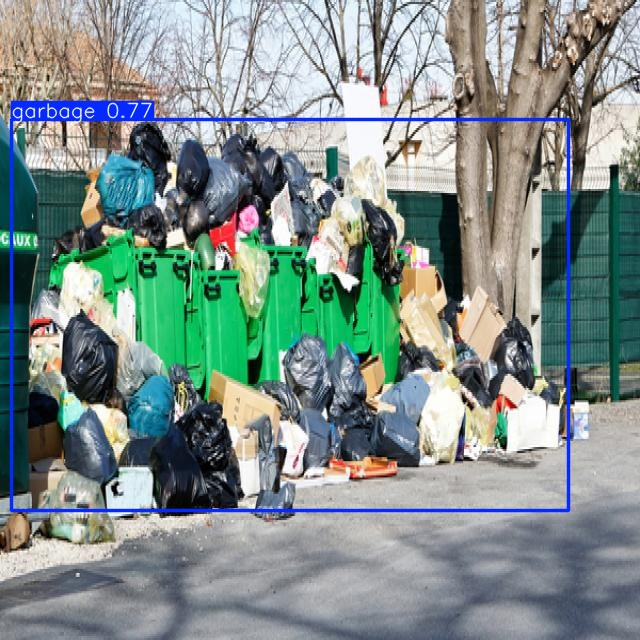

In [36]:
import os
from IPython.display import Image, display

# Get list of predicted images
pred_dir = r'/kaggle/working/runs/detect/predict'
image_files = [f for f in os.listdir(pred_dir) if f.endswith('.jpg')]

# Display up to 5 images (or adjust as needed)
for img_file in image_files[:30]:
    image_path = os.path.join(pred_dir, img_file)
    print(f"Displaying: {img_file}")
    display(Image(filename=image_path))

# Egpt Waste

In [37]:
!yolo task=detect mode=predict model=/kaggle/working/runs/detect/yolov8n_garbage/weights/best.pt source=/kaggle/input/local-waste conf=0.25 save=True

Ultralytics 8.3.117 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs

image 1/4 /kaggle/input/local-waste/IMG-20250426-WA0007.jpg: 640x384 2 garbages, 44.6ms
image 2/4 /kaggle/input/local-waste/IMG-20250426-WA0008.jpg: 640x384 1 garbage, 6.4ms
image 3/4 /kaggle/input/local-waste/IMG-20250426-WA0009.jpg: 640x640 4 garbages, 6.1ms
image 4/4 /kaggle/input/local-waste/IMG-20250426-WA0010.jpg: 640x480 2 garbages, 32.4ms
Speed: 3.0ms preprocess, 22.4ms inference, 46.7ms postprocess per image at shape (1, 3, 640, 480)
Results saved to runs/detect/predict2
💡 Learn more at https://docs.ultralytics.com/modes/predict


In [38]:
!ls /kaggle/working/runs/detect/predict2

IMG-20250426-WA0007.jpg  IMG-20250426-WA0009.jpg
IMG-20250426-WA0008.jpg  IMG-20250426-WA0010.jpg


Displaying: IMG-20250426-WA0008.jpg


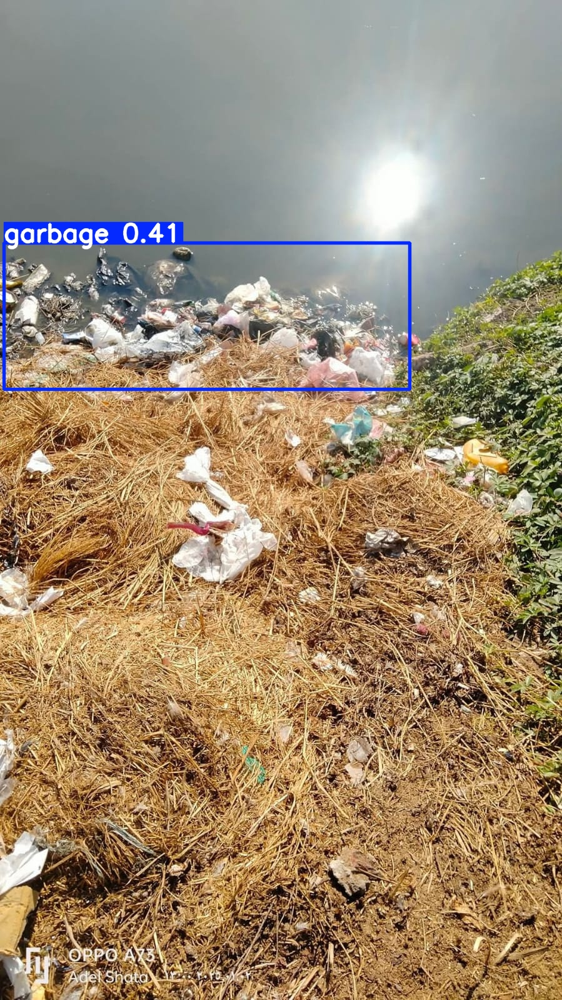

Displaying: IMG-20250426-WA0009.jpg


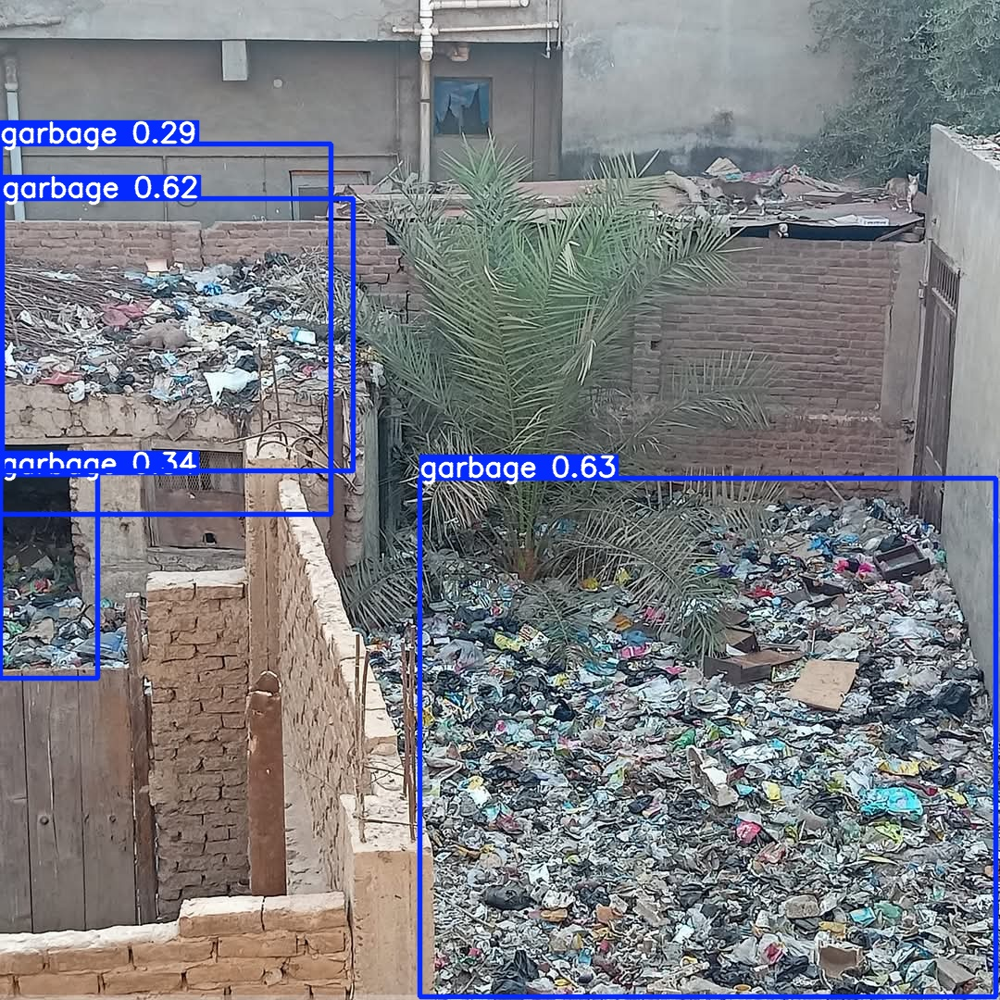

Displaying: IMG-20250426-WA0007.jpg


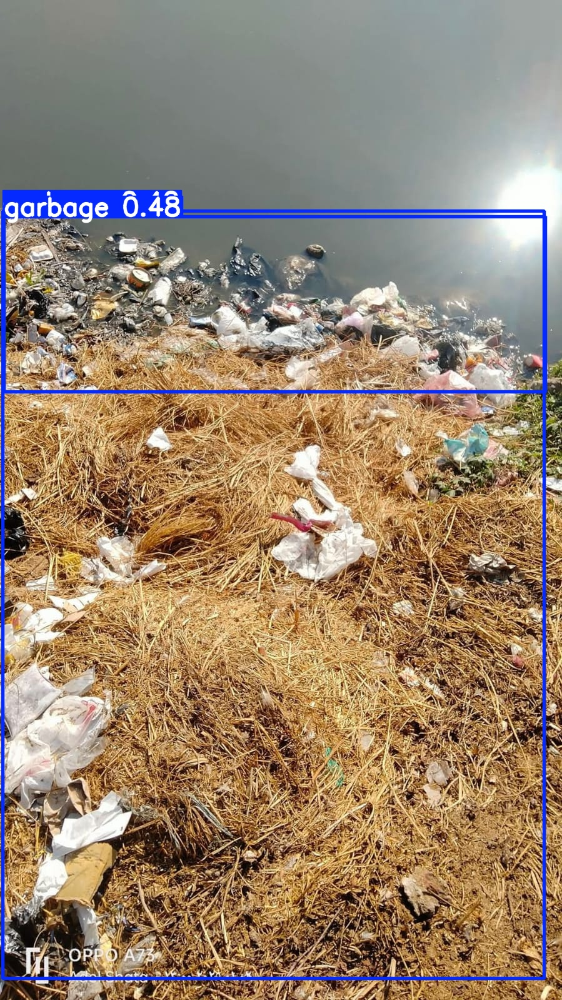

Displaying: IMG-20250426-WA0010.jpg


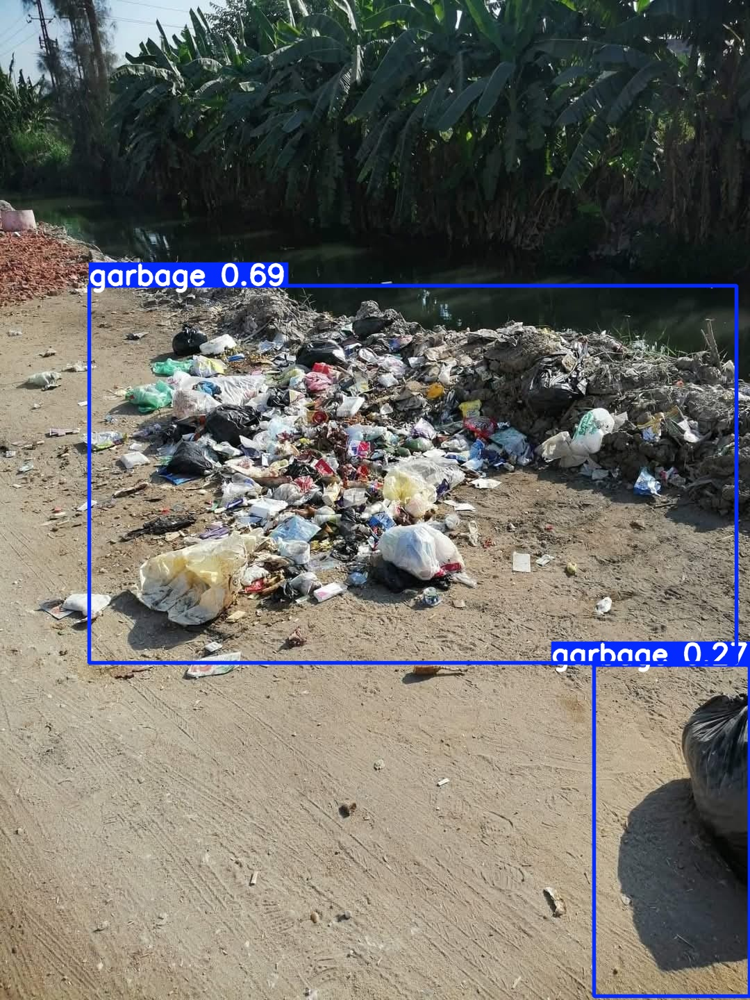

In [41]:
import os
from IPython.display import Image, display

# Directory containing the predicted images
pred_dir = '/kaggle/working/runs/detect/predict2'
image_files = [f for f in os.listdir(pred_dir) if f.endswith('.jpg')]

# Display all images
for img_file in image_files:
    image_path = os.path.join(pred_dir, img_file)
    print(f"Displaying: {img_file}")
    display(Image(filename=image_path))

# Download Tuned Model

In [33]:
# Compress the runs directory
!zip -r /kaggle/working/runs.zip /kaggle/working/runs

  adding: kaggle/working/runs/ (stored 0%)
  adding: kaggle/working/runs/detect/ (stored 0%)
  adding: kaggle/working/runs/detect/yolov8n_garbage/ (stored 0%)
  adding: kaggle/working/runs/detect/yolov8n_garbage/train_batch1.jpg (deflated 1%)
  adding: kaggle/working/runs/detect/yolov8n_garbage/train_batch2.jpg (deflated 1%)
  adding: kaggle/working/runs/detect/yolov8n_garbage/PR_curve.png (deflated 22%)
  adding: kaggle/working/runs/detect/yolov8n_garbage/val_batch1_labels.jpg (deflated 4%)
  adding: kaggle/working/runs/detect/yolov8n_garbage/P_curve.png (deflated 15%)
  adding: kaggle/working/runs/detect/yolov8n_garbage/R_curve.png (deflated 16%)
  adding: kaggle/working/runs/detect/yolov8n_garbage/val_batch0_labels.jpg (deflated 5%)
  adding: kaggle/working/runs/detect/yolov8n_garbage/val_batch1_pred.jpg (deflated 4%)
  adding: kaggle/working/runs/detect/yolov8n_garbage/labels_correlogram.jpg (deflated 35%)
  adding: kaggle/working/runs/detect/yolov8n_garbage/train_batch0.jpg (defla

In [34]:
!ls /kaggle/working

garbage-data  runs  runs.zip  yolo11n.pt  yolov8n.pt
